# Final project for HDEq Skills: 
`Due: Friday 3rd December at midnight`

## Instruction and marking scheme

Your submission (like your assignments) will be a Jupyter Notebook (.ipynb file) and a pdf file.  For your analysis and discussion use Markdown cells instead of comments in the code. Use comments to make your scripts easier to follow and understand.

This assignment contributes 12% of the course mark. It will be marked out of 30, comprising the following:
<br>
**Part 1: 18 marks
<br>
Part 2: 12 marks**
<br>

You are welcome to use previous lab/assignment material.

For the presentation and coding style:
- The plots should be in a good size, properly labelled and markers/lines wisely chosen. It might not be a bad idea to combine some plots and put several curves together for easier comparison and conciseness. 
- Your code should be well commented with meaningful variable names and good structures. You don't need to over comment it though!
- The writing should be clear and concise with minimal language or typing mistakes.


It is important that you think about good academic practice when you construct your answers. The work you submit must reflect **your own understanding**, in line with the School's policy on academic misconduct: https://edin.ac/2LtVQMw. Any form of plagiarism that is detected by the software or markers will be reported to the school for the due process.

## Part 1: Wave equation with linear damping

Consider the following wave equation that includes a damping term

<br>
\begin{equation}
u_{tt} + \nu u_{t} = c^2 u_{xx}
\end{equation}
<br>
with the boundary conditions
\begin{equation}
u\left(x = 0, t\right) = 0 , \quad u\left(x = L, t\right) = 0,
\end{equation}
and the initial conditions
\begin{equation*}
u\left(x, t=0\right) = f(x) = \exp\left(\sin^2\left(\frac{2\pi x}{L}\right)\right)-1 , \quad u_t\left(x, t=0\right) = 0,
\end{equation*}

For this problem, let's set $L=10$, $\nu = 0.1$ and $c = 1$.

We use a method to solve this PDE that is known as "Galerkin". In so doing, we approximate the solution with

\begin{equation*}
u(x, t) \approx \sum_{n=1}^{N} f_n(t) \sin(\lambda_n x) 
\end{equation*}

and then derive an appropriate ODE for $f_n(t)$ to solve numerically. This is a form of separation of variables in which the equations for the functions of time are solved numerically rather than by hand. It can be shown that when $N \to \infty$ the above series converges to the exact solution. 

🚩 **Task 1.1 (1 mark)** Considering the above form of solution, find $\lambda_n$ in terms of $n$ and $L$. 

🚩 **Task 1.2 (1 mark)** Using the assumed form of solution and PDE, find an ODE that describes the evolution of $f_n(t)$ in time, (where $n = 1, 2, \dots, N $).

🚩 **Task 1.3 (2 marks)** Using the initial conditions of the PDE and your knowledge of Fourier series, find two initial conditions for $f_n$ and $\cfrac{df_n}{dt}$ at $t=0$. Your answer in this part might in the form of an integral, which you should not evaluate at this point (we will calculate this integral later numerically).

---------------
*use this cell for your answer*

**Task 1.1**
With $u(x,t)=u_n(x,t)$, we have $$u_n(x=L,t)=0 \Rightarrow f_n(t)sin(\lambda_nL)=0 \Rightarrow sin(\lambda_nL)=0 \Rightarrow \lambda=\frac{n\pi}{L}$$

**Task 1.2**
Substitute the assumed form of solution into the PDE, with $u(x,t)=u_n(x,t)$, we get $$f_n\prime\prime(t)sin(\lambda_nx)+\nu f_n\prime(t)sin(\lambda_nx)+\lambda_n^2sin(\lambda_nx)f_n(t)=0$$ Divide throughout by $sin(\lambda_nx)$ and we have $$f_n\prime\prime(t)+\nu f_n\prime(t)+\frac{n^2\pi^2}{L^2}f_n(t)=0$$ as the required ODE

**Task 1.3**
From the initial condition $u(x,t=0)=f(x)$, we have $$f(x)=\sum_{n=1}^N f_n(0)sin(\frac{n\pi x}{L})$$ Using the formula for finding $c_n$ in Fourier Series of wave equation, we have $$f_n(0)=c_n=\frac{2}{L}\int^L_0f(x)sin(\frac{n\pi x}{L})dx$$ 
From the initial condition $u_t(x,t=0)=0$, we have $$\sum_{n=1}^N f_n\prime(0)sin(\lambda_nx)=0$$ This means that $f_n\prime(0)=0$ for all n

🚩 **Task 1.4 (3 marks)** Write a function that takes $n$ (the index of the terms in the series solution, for example $n=3$ corresponds to $f_3(0)$) as an input and returns $f_n(0)$. You might solve this part using different tools: 1) `sympy` module or 2) direct numerical calculation using  `scipy.integrate` (see the documentation [here](https://docs.scipy.org/doc/scipy/reference/tutorial/integrate.html)). Make sure your final result is a numerical real value (not symbolic expressions). Remember from your labs that you can use `.N()` method to evaluate a sympy expression (if you decide to use `sympy`, which is not the only way to complete this task).

Once you have written your function, use it to calculate $f_n(0)$ for $L=10$, $n=5$ and the given initial condition $u(x, t=0) = \exp\left(\sin^2\left(\frac{2\pi x}{L}\right)\right)-1$.

In [1]:
import sympy as sym
import numpy as np
from scipy import integrate

L=10

def calc_fn_0(k):
    f=lambda x:(np.exp((np.sin(2*np.pi*x/L))**2)-1)*np.sin(k*np.pi*x/L)
    cn=2*integrate.quad(f,0,L)[0]/L
    return cn

In [2]:
print(calc_fn_0(5))

-0.4264022028513228


🚩 **Task 1.5 (4 marks)** Write a function to solve the ODEs that you derived in 'Task 1.2' for each $f_n(t)$. Your function takes $n$ (the index of terms in the solution series) and `t_vec` (the vector of times at which you want to have the solution). Then, it calculates the corresponding initial conditions ($f_n$ and $\cfrac{df}{dt}$ at $t=0$), solves the associated ODE and returns the solution at each point in `t_vec`. Use `odeint` to solve the ODE numerically. You may also use the function you wrote in the previous task.

Use the function to plot $f_1(t)$, $f_2(t)$ and $f_3(t)$ for `t_vec = np.linspace(0, 100, 1001)`.

In [3]:
import matplotlib.pyplot as plt
from scipy.integrate import odeint
# and this is the line in case the figure does not show up!
%matplotlib inline

nu = .1
c = 1
L = 10
    
def dF_dt(F, t, k):
    '''
    this function defines the RHS of the system of ODEs for f_n's
    ----------------------------------------------------
    '''
    return [F[1],-((k*sym.pi)**2)/(L**2)*F[0]-nu*F[1]]
    
def fn_solve(k, t_vec):
    '''
    This function derives the solution of f_k(t) for all the times in 't_vec'
    'k' is given as an input and marks the index of the term in series solution 
    '''
    return odeint(dF_dt,[calc_fn_0(k),0],t_vec,args=(k,))[:,0]

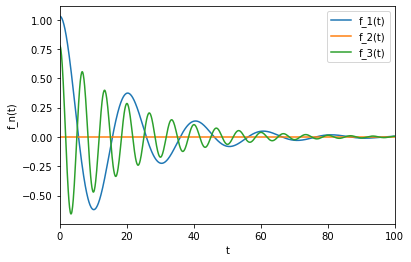

In [4]:
t_vec = np.linspace(0, 100, 1001)
plt.plot(t_vec,fn_solve(1,t_vec))
plt.plot(t_vec,fn_solve(2,t_vec))
plt.plot(t_vec,fn_solve(3,t_vec))
plt.legend(labels=['f_1(t)','f_2(t)','f_3(t)'])
plt.xlabel('t')
plt.ylabel('f_n(t)')
plt.xlim(0,100)
plt.show()

🚩 **Task 1.6 (4 marks)** Write a function that takes $N$ (the total number of terms in the sine series of the solution), `t_vec` and `x_vec` (which is the vector of points in space) as inputs and returns the solution $u(x,t)$ of the PDE at the times `t_vec` and points `x_vec`. Your function output should be a $N_T \times N_X$ numpy array, where $N_T$ is the number of points in time (i.e. the size of `t_vec`) and  $N_X$ is the number of points in space (i.e. the size of `x_vec`). Make good use of the functions you already wrote in the previous tasks.

With this function, find the solution for 

`x_vec = np.linspace(0, L, 201)`

`t_vec = np.linspace(0, 100, 1001)` 

`N =7`

Make an animation to show how $u(x,t)$ changes in time (each frame of animation is the solution at all spatial points but for one specific point in time)

In [5]:
def waveq_dam_solve(N, t_vec, x_vec):
    return np.sum([fn_solve(n, t_vec)[:,None]@np.sin(n*np.pi*x_vec/L)[:,None].T for n in range(1,N+1)],axis=0)


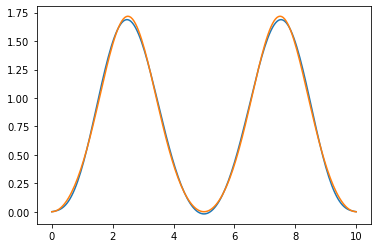

In [6]:
# Assuming the PDE's solution is stored in u_x_t[:,:],
# compare the approx. solution at t=0 with the initial condition
x_vec = np.linspace(0, L, 201)
t_vec = np.linspace(0, 100, 1001)
N =7

u_x_t=waveq_dam_solve(N, t_vec, x_vec)

plt.plot(x_vec, u_x_t[0,:])
plt.plot(x_vec,np.exp((np.sin(2*np.pi*x_vec/L))**2)-1)

In [7]:
import matplotlib.animation as animation
from IPython.display import HTML

nu=0.1
u_x_t=waveq_dam_solve(N, t_vec, x_vec)

fps=10

fig, ax = plt.subplots()
ax.set_ylim(-1,2)
ax.set_xlabel('x')
ax.set_ylabel('u(x,t)')

# set up the initial frame
line, = ax.plot(x_vec,u_x_t[0],color='b')

# add an annotation showing the time (this will be updated in each frame)
txt = ax.text(0, 0.9, 't=0')
plt.close()

def animate(i):
    line.set_ydata(u_x_t[i])  # update the data
    txt.set_text('t='+str(i/fps)) # update the annotation
    return line,txt


ani = animation.FuncAnimation(fig, animate, np.arange(0,100*fps),
                              interval=25, blit=True,repeat=False)
HTML(ani.to_jshtml())

🚩 **Task 1.7 (2 marks)** Examine how the solution changes for different values of $N$. Consider $N=3$, $N=7$ and $N=11$. Show the animation of the solution for all the three cases in one plot and compare them with each other. Discuss and analyse your results (for example, are three terms enough to get an acceptable solution? What about seven?)

In [8]:
nu=0.1
u_3_xt=waveq_dam_solve(3, t_vec, x_vec)
u_7_xt=waveq_dam_solve(7, t_vec, x_vec)
u_11_xt=waveq_dam_solve(11, t_vec, x_vec)

fig, ax = plt.subplots()
ax.set_ylim(-1,2)
ax.set_xlabel('x')
ax.set_ylabel('u(x,t)')

line1,=ax.plot(x_vec,u_3_xt[0],color='b',label='N=3')
line2,=ax.plot(x_vec,u_7_xt[0],color='r',label='N=7')
line3,=ax.plot(x_vec,u_11_xt[0],color='g',label='N=11')
ax.legend()

# add an annotation showing the time (this will be updated in each frame)
txt = ax.text(0, 0.9, 't=0')
plt.close()

def animate(i):
    line1.set_ydata(u_3_xt[i])  # update the data
    line2.set_ydata(u_7_xt[i])
    line3.set_ydata(u_11_xt[i])
    txt.set_text('t='+str(i/fps)) # update the annotation
    return line,txt


ani = animation.FuncAnimation(fig, animate, np.arange(1, 1001),
                              interval=25, blit=True,repeat=False)
HTML(ani.to_jshtml())

From the animation, we can see that using three terms is not enough to get a good approximation as there is a big difference between $N=3$ and $N=7$. However, using seven terms will get a good approximation as there is almost no differnece between $N=7$ and $N=11$.

🚩 **Task 1.8 (1 marks)** Change the damping parameter to $\nu = 1$, and repeat the 'task 1.6' (for $N=7$ and keep all other parameters the same). In few sentences, explain the changes caused by increasing the damping.

In [9]:
nu=1

u_x_t=waveq_dam_solve(N, t_vec, x_vec)

fig, ax = plt.subplots()
ax.set_ylim(-1,2)
ax.set_xlabel('x')
ax.set_ylabel('u(x,t)')

# set up the initial frame
line, = ax.plot(x_vec,u_x_t[0],color='b')

# add an annotation showing the time (this will be updated in each frame)
txt = ax.text(0, 0.9, 't=0')
plt.close()

def animate(i):
    line.set_ydata(u_x_t[i])  # update the data
    txt.set_text('t='+str(i/fps)) # update the annotation
    return line,txt


ani = animation.FuncAnimation(fig, animate, np.arange(1, 1001),
                              interval=25, blit=True,repeat=False)
HTML(ani.to_jshtml())

As $\nu$ increases,$u$ changes much slower as time passes, and the amplitude is also smaller.

## Part 2: Lorenz system


The Lorenz system is given by the coupled set of ODEs
\begin{equation}
  \frac{\mathrm{d}x}{\mathrm{d}t} = -\sigma x + \sigma y, \qquad
  \frac{\mathrm{d}y}{\mathrm{d}t} = x(\rho - z) - y, \qquad
  \frac{\mathrm{d}z}{\mathrm{d}t} = xy - \beta z,
\end{equation}
where ($\rho, \sigma, \beta$) are system parameters. Lorenz derived these equation as a simplified mathematical model for [atmospheric convection](https://en.wikipedia.org/wiki/Atmospheric_convection), which is an aspect of weather.  While the Lorenz system is deterministic, you will find in this problem that in certain sets of parameters there is sensitive dependence of the solution on the initial condition. Assuming this system is a representation of weather, small errors invariably arise (e.g. numerical discretisation, measurements inaccuracy), grow and affect long term solutions (cf. loss of predictability in weather forecasting). However, there are statistical properties (cf. the climatology) that may be robust and may be described accordingly.

--------------------
### Case of stable solution


Consider the parameters $\sigma = 8$, $\beta = 2$ and $\rho = 12$.


🚩 **Task 2.1 (1 mark)** Find all the critical points of this system.

🚩 **Task 2.2 (2 marks)** Using a numerical method of your choice, find the solution starting from $x(t=0) = y(t=0) = z(t=0) = 10$ up to $t=20$. Plot the solution in *x-y*, *y-z* and *x-z* planes (so you need three plots). Where does this initial condition end up in? Can you express the exact location of this solution as $t \to \infty$? Make sure your timestep is small enough to have robust results. You can check this by running your code for several different timesteps.

The critical points are 
\begin{equation}
x=0,y=0,z=0
\end{equation}

\begin{equation}
x=\sqrt{22},y=\sqrt{22},z=11
\end{equation}

\begin{equation}
x=-\sqrt{22},y=-\sqrt{22},z=11
\end{equation}

In [10]:
# Task 2.2
import numpy as np
from scipy.integrate import odeint
import matplotlib.pyplot as plt

rho = 12.0
sigma = 8.0
beta = 2.0

n=1

def func_x(x,y,z):
    return sigma*(y-x)
    
def func_y(x,y,z):
    return x*(rho-z)-y

def func_z(x,y,z):
    return x*y-beta*z

def func(args):
    x=args[0]
    y=args[1]
    z=args[2]
    return np.array([func_x(x,y,z),func_y(x,y,z),func_z(x,y,z)])

def ode_RK4(func, h,nT,y0):
    y0 = np.array(y0)
    n = y0.size       # the dimension of ODE 
    y = np.zeros([nT,n])
    y[0, :] = y0
    for k in range (nT-1):
        k1=func(y[k,:])
        k2=func(y[k,:]+0.5*h*k1)
        k3=func(y[k,:]+0.5*h*k2)
        k4=func(y[k,:]+h*k3)
        y[k+1, :] =y[k,:]+(h/6)*(k1+2*k2+2*k3+k4)
    return y[:,0],y[:,1],y[:,2]

In [11]:
y0=[10,10,10]
h=0.001
nT=int(np.rint(20/h))+1

x,y,z=ode_RK4(func,h,nT,y0)

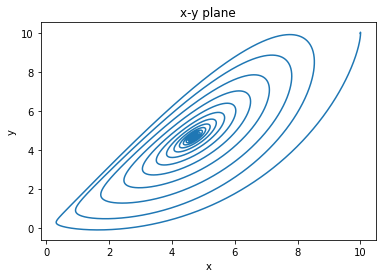

In [12]:
plt.plot(x,y)
plt.title('x-y plane')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

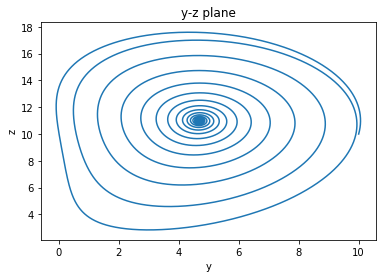

In [13]:
plt.plot(y,z)
plt.title('y-z plane')
plt.xlabel('y')
plt.ylabel('z')
plt.show()

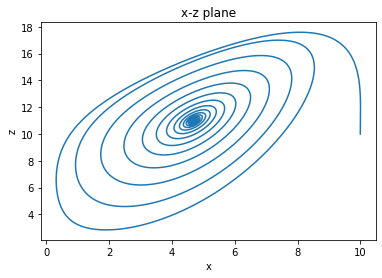

In [14]:
plt.plot(x,z)
plt.title('x-z plane')
plt.xlabel('x')
plt.ylabel('z')
plt.show()

🚩 **Task 2.3 (4 marks)** Consider two different numerical methods: forward Euler and Ruge-kutta (4th order) methods. Set the initial condition to $x = y = z = 100$ and the final time to 0.3. The Ruge-kutta method with timestep $h=10^{-6}$ is accurate enough that **we can regard it as an exact solution**. Using this *estimate numerically* the **global error** for variable $x$ and plot it in log-scale as a function of timestep. In so doing, consider the values `[0.002, 0.001, .0005, 0.0002, 0.0001]` for timesteps. 

Note that the order of error can be estimated from the slope of plots in log-scales. If a function is proportional to $h^{6}$, then in log-scale it looks linear and have the slope of $6$.

What is the slope of global error vs timestep for each method? Why do you get these slopes? You can estimate the slopes by drawing linear guidelines. For example, if you draw $h^{6}$ and your curve is close to this guideline, then you can conclude that the slope is close to $6$. You need to shift your guidelines up and down to bring them closer to the results of numerical solutions. Are the results different than the slopes you expect for the local error as a function of timestep? Can you reason why?


(Remember that you have already implemented forward Euler and Ruge-kutta in your lab notebooks. There is also something called "copy-paste".)

In [15]:
def ode_Euler(func,h,nT, y0):
    y0 = np.array(y0)
    n = y0.size       # the dimension of ODE 
    y = np.zeros([nT,n])
    y[0, :] = y0
    # loop for timesteps
    for k in range(nT-1):
        y[k+1, :] = y[k, :] + h*func(y[k, :])
    return y

In [16]:
rho = 12.0
sigma = 8.0
beta = 2.0

y0=[100,100,100]
final_time=0.3
hh=np.array([0.002,0.001,0.0005,0.0002,0.0001])

x_exact,y_exact,z_exact=ode_RK4(func,0.000001,int(np.rint(final_time/0.000001))+1,y0)

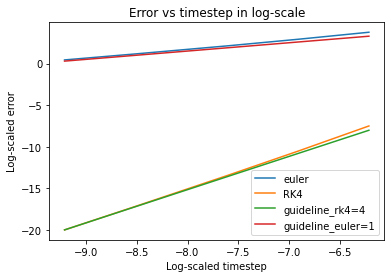

In [18]:
error_euler=[]
error_rk4=[]

for i in range(5):
    h=hh[i]
    nT=int(np.rint(final_time/h))+1
    x_euler=ode_Euler(func,h,nT,y0)[:,0]
    x_rk4,y_rk4,z_rk4=ode_RK4(func,h,nT,y0)
    global_error_euler=np.absolute(x_exact[-1]-x_euler[-1])
    global_error_rk4=np.absolute(x_exact[-1]-x_rk4[-1])
    error_euler.append(global_error_euler)
    error_rk4.append(global_error_rk4)
log_h=np.log(hh)
y_guideline=[]
log_euler_error=np.log(error_euler)
log_rk4_error=np.log(error_rk4)
plt.plot(log_h,log_euler_error,label='euler')
plt.plot(log_h,log_rk4_error,label='RK4')
plt.plot([log_h[-1],log_h[0]],[-20,-20+4*(log_h[0]-log_h[-1])],label='guideline_rk4=4')
plt.plot([log_h[-1],log_h[0]],[0.3,0.3+log_h[0]-log_h[-1]],label='guideline_euler=1')
plt.title('Error vs timestep in log-scale')
plt.xlabel('Log-scaled timestep')
plt.ylabel('Log-scaled error')
plt.legend()
plt.show()

The local truncation error of Runge-Kutta method is proportional to $h^5$, which means the global error is proportional to $h^4$ because we need to sum the local errors over all iterations which is inversely proportional to h. As can be seen from the graph that the slope of error using RK4 is indeed very close to the guideline (which is 4) except for larger timesteps that the slope is slightly bigger than the guideline.

The local truncation error of Euler's method is proportional to $h^2$, which means the global error is proportional to $h$. As can be seen from the graph that the slope of error using Euler's method is indeed very close to the guideline (which is 1) except for larger timesteps that the slope is slightly bigger than the guideline.

--------------------
### Case of chaotic behaviour and strange attractor


Consider the set of parameters $\sigma = 8/3$, $\beta = 4$ and $\rho = 6$ and stick to Runge-Kutta scheme with timestep of $h = 10^{-4}$ for this part. 

**Task 2.4 (2 marks)** Draw the three-dimensional phase portraits using $x = y = z = 1$ as initial condition. You can use the script below to plot 3D curves.


**Task 2.5 (3 marks)** Change the initial condition as $x = 1 + \epsilon, y = 1, z = 1$, where $\epsilon$ is $10^{-1}$, $10^{-5}$ and $10^{-12}$. Draw the phase portrait for each initial condition and compare it to what you got for Task 2.4. Do they look different? Representing the outputs of these new solutions (with new initial conditions) with $x_1$, $y_1$ and $z_1$ and the solution starting from $x = y = z = 1$ with $x^*$, $y^*$ and $z^*$, compute a measure of difference between these solutions given by
  
\begin{equation*}
\mathcal{e}(t) = \sqrt{(x^*(t) - x_1(t))^2 +  (y^*(t) - y_1(t))^2 + (z^*(t) - z_1(t))^2}.
\end{equation*}
  
Plot the time-series diagrams of $\mathcal{e}(t)$ for three different values of $\epsilon$. From the behaviour of $\mathcal{e}(t)$ answer the following questions:

- If two initial conditions are very close, do their corresponding trajectories stay close to each other in time? 

- Do you see an upper bound for $\mathcal{e}(t)$? What does this imply?
  
  
*The moral of the story is that the exact realisations (the "weather") can have sensitive dependence on initial conditions, and in reality errors always exist, so loss of accuracy in weather prediction is fairly rapid. However there are gross features that remain roughly invariant and can be described, for example the butterfly attractor that you see in your results (the "climate").*

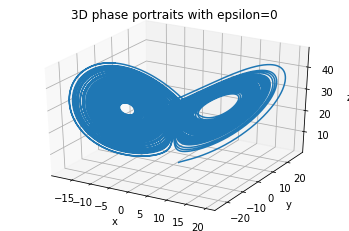

In [20]:
# some hint how to create 3D plots for phase portraits
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import pyplot as plt
from scipy.integrate import odeint
%matplotlib inline

# set the parameters
rho = 28.
sigma = 10.
beta = 8.0/3.0

# timestep
h =1e-3
# end time
tstop = 100

nT=int(np.rint(tstop/h))+1

# starting point in time
tstart = 0



def phase_portrait(epsilon):
    y0=[1+epsilon,1,1]
    x,y,z=ode_RK4(func,h,nT,y0)
    fig = plt.figure()
    ax = fig.gca(projection="3d")
    ax.plot(x, y, z) # x and y and z are the time series of the solution
    ax.set_title('3D phase portraits with epsilon='+str(epsilon))
    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_zlabel('z')
    plt.draw()
    plt.show()
    return x,y,z

x,y,z=phase_portrait(0)

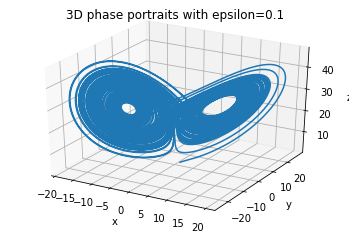

In [21]:
x1,y1,z1=phase_portrait(1e-1)

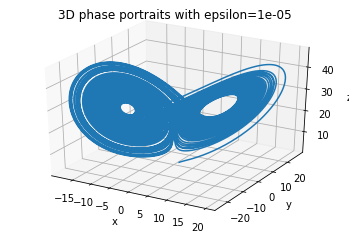

In [22]:
x2,y2,z2=phase_portrait(1e-5)

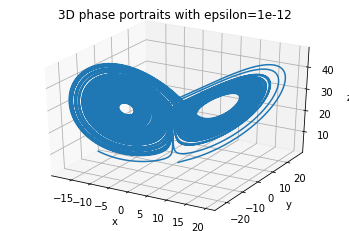

In [23]:
x3,y3,z3=phase_portrait(1e-12)

We can see that the graphs look similar closer to the center. However, they look different on the outside.

In [30]:
def mse(xx,yy,zz,i):
    return np.sqrt((x[i]-xx[i])**2+(y[i]-yy[i])**2+(z[i]-zz[i])**2)

num_steps=len(x)
e1=[mse(x1,y1,z1,i) for i in range(num_steps)]
e2=[mse(x2,y2,z2,i) for i in range(num_steps)]
e3=[mse(x3,y3,z3,i) for i in range(num_steps)]

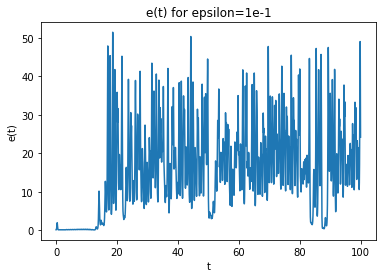

In [31]:
timesteps=np.linspace(tstart,tstop,nT)
plt.plot(timesteps,e1)
plt.title('e(t) for epsilon=1e-1')
plt.xlabel('t')
plt.ylabel('e(t)')
plt.show()

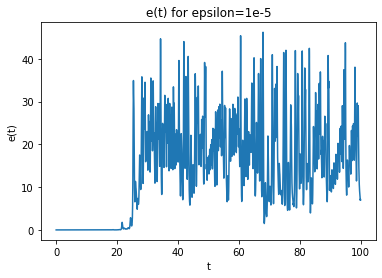

In [32]:
plt.plot(timesteps,e2)
plt.title('e(t) for epsilon=1e-5')
plt.xlabel('t')
plt.ylabel('e(t)')
plt.show()

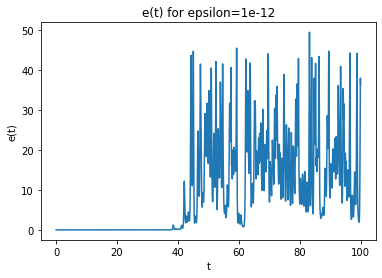

In [33]:
plt.plot(timesteps,e3)
plt.title('e(t) for epsilon=1e-12')
plt.xlabel('t')
plt.ylabel('e(t)')
plt.show()

If two initial conditions are closer, their trajectories will stay close for a longer period of time from the beginning.However, the trajectories will still deviate after some time.

We can see that 50 is an upper bound for $e(t)$. This implies that despite of the errors existing, they are kept within a certain range so that the approximation is kept reliable within that range.